In [1]:
import pandas as pd
import numpy as np
from pyspark.sql import SparkSession
from pyspark.sql.functions import udf, pandas_udf, PandasUDFType, lit
from pyspark.sql.types import DoubleType, StructType, StructField
from pyspark.sql.functions import round
from IPython.display import display, HTML
import time
import os
import pandas as pd

# Hotfix
!cp /runtime-addons/cmladdon-2.0.40-b150/log4j.properties /etc/spark/conf/

# Create a Spark session
spark = SparkSession\
    .builder\
    .appName("geodistance")\
    .config("spark.hadoop.fs.azure.ext.cab.required.group","eur-app-aiu-dev")\
    .config("spark.yarn.access.hadoopFileSystems","abfs://storage-fs@cdpdldev0.dfs.core.windows.net/")\
    .config("spark.driver.cores","1")\
    .config("spark.driver.memory","8G")\
    .config("spark.executor.memory","5G")\
    .config("spark.executor.cores","1")\
    .config("spark.executor.instances","2")\
    .config("spark.dynamicAllocation.maxExecutors", "6")\
    .config("spark.rpc.message.maxSize", "200")\
    .getOrCreate()

# Get environment variables
engine_id = os.getenv('CDSW_ENGINE_ID')
domain = os.getenv('CDSW_DOMAIN')

# Format the URL
url = f"https://spark-{engine_id}.{domain}"

# Display the clickable URL
display(HTML(f'<a href="{url}">{url}</a>'))

Setting spark.hadoop.yarn.resourcemanager.principal to quinten.goens


In [2]:
from pyspark.sql import SparkSession, functions as F
from pyspark.sql.window import Window
from pyspark.sql.types import DoubleType
from pyspark.sql.functions import lead, lag, col, when, lit, row_number

# Initialize Spark session
spark = SparkSession.builder.appName("flight_level_crossing").getOrCreate()

# Read data from the database (this should be your own database and query)
track_df = spark.sql("""
    SELECT *
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 50000
""")

# Convert meters to flight level and create a new column
track_df = track_df.withColumn("FL", (F.col("baro_altitude") * 3.28084 / 100).cast(DoubleType())).cache()

# Window specification to order by event_time for each track_id
window_spec = Window.partitionBy("track_id").orderBy("event_time")

# Add columns with lead and lag FL values
track_df = track_df.withColumn("next_FL", F.lead("FL").over(window_spec))
track_df = track_df.withColumn("prev_FL", F.lag("FL").over(window_spec))

# Define the conditions for a crossing for each flight level of interest
crossing_conditions = [
    (F.col("FL") < 50) & (F.col("next_FL") >= 50), # going up
    (F.col("FL") >= 50) & (F.col("prev_FL") < 50), # going down
    (F.col("FL") < 70) & (F.col("next_FL") >= 70),
    (F.col("FL") >= 70) & (F.col("prev_FL") < 70),
    (F.col("FL") < 100) & (F.col("next_FL") >= 100),
    (F.col("FL") >= 100) & (F.col("prev_FL") < 100),
    (F.col("FL") < 245) & (F.col("next_FL") >= 245),
    (F.col("FL") >= 245) & (F.col("prev_FL") < 245)
]

# Create a crossing column using multiple when conditions
crossing_column = F.when(crossing_conditions[0], 50)
for condition, flight_level in zip(crossing_conditions[1:], [50, 70, 70, 100, 100, 245, 245]):
    crossing_column = crossing_column.when(condition, flight_level)

track_df = track_df.withColumn("crossing", crossing_column)

# Filter out only the rows where a crossing was detected
crossing_points = track_df.filter(col("crossing").isNotNull())
track_df.unpersist()

# Filter out only the rows where the absolute difference between crossing and FL is less than 10 -> This filters out obvious errors
crossing_points = crossing_points.filter(F.abs(F.col("crossing") - F.col("FL")) < 10)

# Identify first and last crossings by using window functions again
# Note that we need a separate window specification for descending order
window_spec_crossing_asc = Window.partitionBy("track_id", "crossing").orderBy("event_time")
window_spec_crossing_desc = Window.partitionBy("track_id", "crossing").orderBy(F.col("event_time").desc())

crossing_points = crossing_points.withColumn(
    "row_number_asc",
    F.row_number().over(window_spec_crossing_asc)
)
crossing_points = crossing_points.withColumn(
    "row_number_desc",
    F.row_number().over(window_spec_crossing_desc)
)

# Filter first and last crossings
first_crossings = crossing_points.filter(F.col("row_number_asc") == 1)
last_crossings = crossing_points.filter(F.col("row_number_desc") == 1)

# Drop the temporary columns used for row numbering
first_crossings = first_crossings.drop("row_number_asc", "row_number_desc")
last_crossings = last_crossings.drop("row_number_asc", "row_number_desc")

# Add a label to indicate first or last crossing
first_crossings = first_crossings.withColumn("crossing_type", F.lit("first"))
last_crossings = last_crossings.withColumn("crossing_type", F.lit("last"))

# Combine the first and last crossing data
all_crossings = first_crossings.union(last_crossings)

# Show the result
all_crossings_pdf = all_crossings.toPandas()
all_crossings_pdf.to_parquet('all_crossings.parquet')

# Stop the Spark session if it's the end of your application
spark.stop()

Hive Session ID = efd335ab-999f-4d8f-9f12-d7e7c3c1821b


In [2]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import pandas_udf, PandasUDFType
from openap.phase import FlightPhase
from pyspark.sql import SparkSession, functions as F
from pyspark.sql.window import Window
from pyspark.sql.types import DoubleType, IntegerType, StringType
from pyspark.sql.functions import lead, lag, col, when, lit, row_number


# Read your data into a PySpark DataFrame

df = spark.sql("""
    SELECT track_id, event_time, baro_altitude, velocity, vert_rate
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 50000
""")

# Convert baro_altitude from meters to feet (1 meter = 3.28084 feet)
df = df.withColumn("altitude_ft", col("baro_altitude") * 3.28084)

# Convert vert_rate from meters per second to feet per minute (1 m/s = 196.850394 ft/min)
df = df.withColumn("roc_ft_min", col("vert_rate") * 196.850394)

# Assuming 'velocity' is in meters per second and needs to be converted to knots
# (1 meter per second = 1.94384 knots)
df = df.withColumn("speed_kt", col("velocity") * 1.94384)

schema = StructType([
    StructField("track_id", StringType()),
    StructField("event_time", IntegerType()),
    StructField("baro_altitude", DoubleType()),
    StructField("velocity", DoubleType()),
    StructField("vert_rate", DoubleType()),
    StructField("altitude_ft", DoubleType()),
    StructField("roc_ft_min", DoubleType()),
    StructField("speed_kt", DoubleType()),
    StructField("flight_phase", StringType())
])

# Define a UDF that applies the flight phase logic to a Pandas DataFrame
@pandas_udf(schema, PandasUDFType.GROUPED_MAP)
def get_flight_phases(pdf):
    # Access the broadcasted FlightPhase object
    fp = FlightPhase()

    # Set the trajectory data
    fp.set_trajectory(pdf['event_time'], pdf['altitude_ft'], pdf['speed_kt'], pdf['roc_ft_min'])

    # Get the phase labels
    pdf['flight_phase'] = fp.phaselabel()

    return pdf

# Group the data by some identifier of a trajectory, e.g., flight_id
# and apply the UDF to each group
df_with_phases = df.groupby("track_id").apply(get_flight_phases)

# Show the result
pdf_with_phases = df_with_phases.toPandas()

Hive Session ID = 964eebb4-6a0e-4a46-9e88-8b499e47275f
/opt/spark/python/lib/pyspark.zip/pyspark/sql/pandas/group_ops.py:81: UserWarning: It is preferred to use 'applyInPandas' over this API. This API will be deprecated in the future releases. See SPARK-28264 for more details.


In [3]:
pdf_with_phases

,track_id,event_time,baro_altitude,velocity,vert_rate,altitude_ft,roc_ft_min,speed_kt,flight_phase
0,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719740,579.12,89.958591,12.35456,1900.000061,2432.000004,174.865108,CL
1,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719740,579.12,89.958591,12.35456,1900.000061,2432.000004,174.865108,CL
2,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719740,579.12,89.958591,12.35456,1900.000061,2432.000004,174.865108,CL
3,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719750,655.32,97.322417,7.80288,2150.000069,1536.000002,189.179208,CL
4,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719750,655.32,97.322417,7.80288,2150.000069,1536.000002,189.179208,CL
...,...,...,...,...,...,...,...,...,...
49995,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652280,243.84,70.705645,-4.22656,800.000026,-832.000001,137.440460,DE
49996,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652290,205.74,71.218450,-3.25120,675.000022,-640.000001,138.437272,NA
49997,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652290,205.74,71.218450,-3.25120,675.000022,-640.000001,138.437272,NA
49998,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652300,167.64,71.218450,-3.90144,550.000018,-768.000001,138.437272,NA


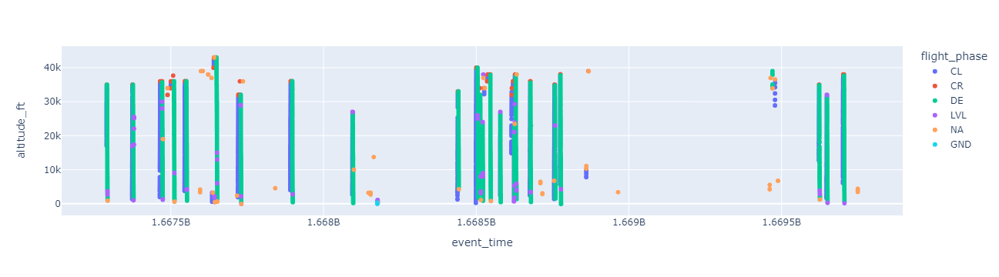

In [4]:
import plotly.express as px
px.scatter(pdf_with_phases, x='event_time',y='altitude_ft', color = 'flight_phase')

In [16]:
df = pd.read_parquet('all_crossings_pdf.parquet')

In [20]:
import plotly.express as px

In [36]:
df.groupby(['track_id']).count().event_time.max()

4

/tmp/ipykernel_193/4052596413.py:1: FutureWarning:

The 'freq' argument in Timestamp is deprecated and will be removed in a future version.



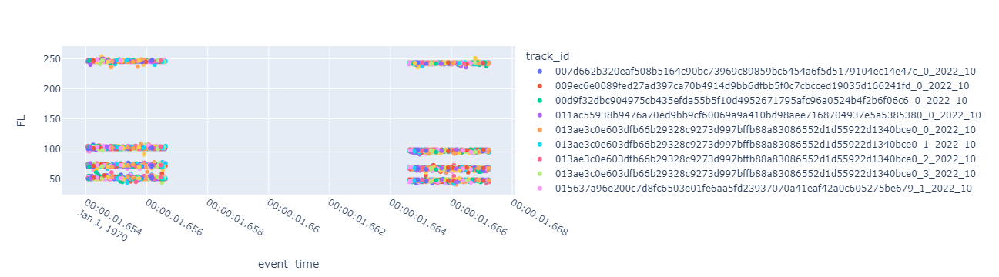

In [30]:
df['event_time'] = df['event_time'].apply(lambda l: pd.Timestamp(l, 's'))
px.scatter(df, x='event_time', y = 'FL', color = 'track_id')

In [3]:
df['FL_diff'] = df['FL'] - df['crossing']

In [4]:
track_ids = df[df['FL_diff'].apply(abs) > 10].track_id.to_list()[:10]

# Convert the list of track_ids to a tuple, which is safe to include in a SQL query.
# If track_ids is empty, the IN clause will throw an error, hence we check for that.
track_ids_tuple = tuple(track_ids) if track_ids else (None,)

# Now, you can format the SQL query string using the track_ids_tuple.
# You need to ensure the tuple is converted to a string properly if there's only one id (adding a comma).
track_ids_str = str(track_ids_tuple)
if len(track_ids) == 1:
    track_ids_str = f"({track_ids_tuple[0]},)"  # For a single element, make it a tuple

# Construct the query using the formatted string.
query = f"""
    SELECT *
    FROM `project_aiu`.`osn_tracks_clustered`
    WHERE track_id IN {track_ids_str}
"""

# Execute the query with Spark SQL.
track_df = spark.sql(query).toPandas()

Hive Session ID = eb0d2648-6ac1-4d55-92a5-597936941b58


In [5]:
track_df.to_parquet('track_df.parquet')

In [6]:
track_df

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,spi,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,serials,track_id,h3_id_res_11
0,1662641640,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,"[1801277291, 696601879]",7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
1,1662641640,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,"[1801277291, 696601879]",7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
2,1662641640,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,"[1801277291, 696601879]",7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
3,1662641650,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,[696601879],7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
4,1662641650,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,[696601879],7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22794,1663333890,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff
22795,1663333890,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff
22796,1663333900,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff
22797,1663333900,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff


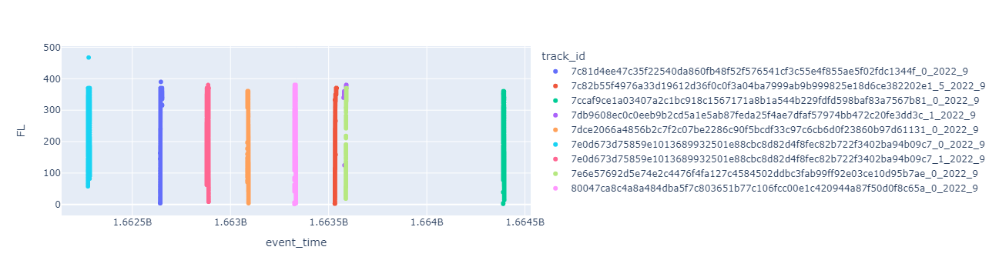

In [10]:
import plotly.express as px
track_df['FL']=track_df['baro_altitude']* 3.28084 / 100
px.scatter(track_df, x='event_time', y = 'FL', color = 'track_id')

In [2]:
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.window import Window
from pyspark.sql import DataFrame

def calculate_cumulative_distance(df: DataFrame) -> DataFrame:
    """
    Calculate the great circle distance between consecutive points in nautical miles
    and the cumulative distance for each track, using native PySpark functions.

    Parameters:
    df (DataFrame): Input Spark DataFrame. Assumes columns "lat", "lon", "track_id", "event_time".

    Returns:
    DataFrame: DataFrame with additional columns "distance_nm" and "cumulative_distance_nm".
    """

    # Define a window spec for lag operation and cumulative sum
    windowSpecLag = Window.partitionBy("track_id").orderBy("event_time")
    windowSpecCumSum = Window.partitionBy("track_id").orderBy("event_time").rowsBetween(Window.unboundedPreceding, 0)

    # Convert degrees to radians using PySpark native function
    df = df.withColumn("lat_rad", F.radians(F.col("lat")))
    df = df.withColumn("lon_rad", F.radians(F.col("lon")))

    # Getting previous row's latitude and longitude
    df = df.withColumn("prev_lat_rad", F.lag("lat_rad").over(windowSpecLag))
    df = df.withColumn("prev_lon_rad", F.lag("lon_rad").over(windowSpecLag))

    # Compute the great circle distance using haversine formula in PySpark native functions
    df = df.withColumn("a", 
                       F.sin((F.col("lat_rad") - F.col("prev_lat_rad")) / 2)**2 + 
                       F.cos(F.col("prev_lat_rad")) * F.cos(F.col("lat_rad")) * 
                       F.sin((F.col("lon_rad") - F.col("prev_lon_rad")) / 2)**2)

    df = df.withColumn("c", 2 * F.atan2(F.sqrt(F.col("a")), F.sqrt(1 - F.col("a"))))

    # Radius of Earth in kilometers is 6371
    df = df.withColumn("distance_km", 6371 * F.col("c"))

    # Convert distance to nautical miles; 1 nautical mile = 1 / 1.852 km
    df = df.withColumn("distance_nm", F.col("distance_km") / 1.852)

    # Calculate the cumulative distance
    df = df.withColumn("cumulative_distance_nm", F.sum("distance_nm").over(windowSpecCumSum))

    # Drop temporary columns used for calculations
    df = df.drop("lat_rad", "lon_rad", "prev_lat_rad", "prev_lon_rad", "a", "c", "distance_km")

    return df

# Read the data (assuming data is in place)
df = spark.sql("""
    SELECT *
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 100000;
""")

# Calculate distances
df_with_distances = calculate_cumulative_distance(df)

# Calculate first milestones

## Flight levels FL50, FL70, FL100, FL245

Hive Session ID = 669ad2ae-01eb-433b-91cd-34157947e191


In [10]:


# Convert meters to flight level and create a new column
track_df = track_df.withColumn("FL", (col("baro_altitude") * 3.28084 / 100).cast("integer"))

# Define the flight levels of interest
FL = [40, 70, 100, 245]

# Window specification to order by event_time for each track_id
window_spec = Window.partitionBy("track_id").orderBy("event_time")

# Add columns with lead and lag FL values
track_df = track_df.withColumn("next_FL", lead("FL").over(window_spec))
track_df = track_df.withColumn("prev_FL", lag("FL").over(window_spec))

# Define the conditions for a crossing
conditions = []
for fl in FL:
    condition = ((col("FL") < fl) & (col("next_FL") >= fl)) | \
                ((col("FL") >= fl) & (col("prev_FL") < fl))
    conditions.append(when(condition, fl))

# Create the crossing column
crossing_col = when(conditions[0], lit(FL[0]))
for i in range(1, len(conditions)):
    crossing_col = crossing_col.when(conditions[i], lit(FL[i]))

track_df = track_df.withColumn("crossing", crossing_col)

# Filter out only the rows where a crossing was detected
crossing_points = track_df.filter(col("crossing").isNotNull())

# Identify first and last crossings by using window functions again
window_spec_crossing = Window.partitionBy("track_id", "crossing").orderBy("event_time")
crossing_points = crossing_points.withColumn("row_number_asc", row_number().over(window_spec_crossing))
crossing_points = crossing_points.withColumn("row_number_desc", row_number().over(window_spec_crossing.orderBy(col("event_time").desc())))

# Filter first and last crossings
first_crossings = crossing_points.filter(col("row_number_asc") == 1).drop("row_number_asc", "row_number_desc", "next_FL", "prev_FL")
last_crossings = crossing_points.filter(col("row_number_desc") == 1).drop("row_number_asc", "row_number_desc", "next_FL", "prev_FL")

# Add a label to indicate first or last crossing
first_crossings = first_crossings.withColumn("crossing_type", lit("first"))
last_crossings = last_crossings.withColumn("crossing_type", lit("last"))

# Combine the first and last crossing data
all_crossings = first_crossings.union(last_crossings)

# Show the result
all_crossings.show()

# Stop the Spark session if it's the end of your application
spark.stop()


AnalysisException: cannot resolve 'CASE WHEN CASE WHEN (((FL < 40) AND (next_FL >= 40)) OR ((FL >= 40) AND (prev_FL < 40))) THEN 40 END THEN 40 WHEN CASE WHEN (((FL < 70) AND (next_FL >= 70)) OR ((FL >= 70) AND (prev_FL < 70))) THEN 70 END THEN 70 WHEN CASE WHEN (((FL < 100) AND (next_FL >= 100)) OR ((FL >= 100) AND (prev_FL < 100))) THEN 100 END THEN 100 WHEN CASE WHEN (((FL < 245) AND (next_FL >= 245)) OR ((FL >= 245) AND (prev_FL < 245))) THEN 245 END THEN 245 END' due to data type mismatch: WHEN expressions in CaseWhen should all be boolean type, but the 1th when expression's type is CASE WHEN (((FL#133 < 40) AND (next_FL#154 >= 40)) OR ((FL#133 >= 40) AND (prev_FL#176 < 40))) THEN 40 END;
'Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, prev_FL#176, CASE WHEN CASE WHEN (((FL#133 < 40) AND (next_FL#154 >= 40)) OR ((FL#133 >= 40) AND (prev_FL#176 < 40))) THEN 40 END THEN 40 WHEN CASE WHEN (((FL#133 < 70) AND (next_FL#154 >= 70)) OR ((FL#133 >= 70) AND (prev_FL#176 < 70))) THEN 70 END THEN 70 WHEN CASE WHEN (((FL#133 < 100) AND (next_FL#154 >= 100)) OR ((FL#133 >= 100) AND (prev_FL#176 < 100))) THEN 100 END THEN 100 WHEN CASE WHEN (((FL#133 < 245) AND (next_FL#154 >= 245)) OR ((FL#133 >= 245) AND (prev_FL#176 < 245))) THEN 245 END THEN 245 END AS crossing#199]
+- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, prev_FL#176]
   +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, prev_FL#176, prev_FL#176]
      +- Window [lag(FL#133, -1, null) windowspecdefinition(track_id#112, event_time#95L ASC NULLS FIRST, specifiedwindowframe(RowFrame, -1, -1)) AS prev_FL#176], [track_id#112], [event_time#95L ASC NULLS FIRST]
         +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154]
            +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154]
               +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, next_FL#154]
                  +- Window [lead(FL#133, 1, null) windowspecdefinition(track_id#112, event_time#95L ASC NULLS FIRST, specifiedwindowframe(RowFrame, 1, 1)) AS next_FL#154], [track_id#112], [event_time#95L ASC NULLS FIRST]
                     +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133]
                        +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, cast(((baro_altitude#107 * 3.28084) / cast(100 as double)) as int) AS FL#133]
                           +- GlobalLimit 1000000
                              +- LocalLimit 1000000
                                 +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113]
                                    +- SubqueryAlias spark_catalog.project_aiu.osn_tracks_clustered
                                       +- Relation project_aiu.osn_tracks_clustered[event_time#95L,icao24#96,lat#97,lon#98,velocity#99,heading#100,vert_rate#101,callsign#102,on_ground#103,alert#104,spi#105,squawk#106,baro_altitude#107,geo_altitude#108,last_pos_update#109,last_contact#110,serials#111,track_id#112,h3_id_res_11#113] parquet


In [3]:
import pandas as pd
from pyspark.sql.functions import concat, col, lit, year, month
import plotly.express as px

track_df = spark.sql(f"""
    SELECT * 
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 1000000;
""")

track_pdf = track_df.toPandas()

def meters_to_flight_level(baro_altitude_meters):
    """
    Convert barometric altitude in meters to Flight Level.
    
    Parameters:
        baro_altitude_meters (float): Barometric altitude in meters.
        
    Returns:
        int: Flight Level in hundreds of feet.
    """
    if pd.isnull(baro_altitude_meters):
        return None
    # Convert altitude from meters to feet
    baro_altitude_feet = baro_altitude_meters * 3.28084
    
    # Calculate Flight Level
    flight_level = float(baro_altitude_feet / 100)
    
    return flight_level

track_pdf['FL'] = track_pdf['baro_altitude'].apply(lambda l:meters_to_flight_level(l))

# Define your Flight Levels of interest
FL = [40, 70, 100, 245]

# Assuming 'track_pdf' DataFrame contains 'track_id', 'event_time', and 'FL' columns
# And 'FL' column is already populated with the flight levels

# Function to find the first and last crossing of flight levels for each track
def label_crossings(df, flight_levels):
    df = df.sort_values(['track_id', 'event_time'])  # Sort the DataFrame for consistency
    df['crossing'] = None  # New column to identify crossing points
    
    for track_id, group in df.groupby('track_id'):
        previous_fl = None
        for i, row in group.iterrows():
            # Check for ascending and descending crossings
            for fl in flight_levels:
                if previous_fl and ((previous_fl < fl and row['FL'] >= fl) or (previous_fl > fl and row['FL'] <= fl)):
                    df.at[i, 'crossing'] = fl
                    break  # Only consider one crossing at a time
            previous_fl = row['FL']

    return df

# Apply the labeling function to the DataFrame
track_pdf = label_crossings(track_pdf, FL)

# Now, filter out only the rows where a crossing was detected
crossing_points = track_pdf.dropna(subset=['crossing'])

# Determine the first and last crossings
first_crossings = crossing_points.drop_duplicates(subset=['track_id', 'crossing'], keep='first')
last_crossings = crossing_points.drop_duplicates(subset=['track_id', 'crossing'], keep='last')

# Add a label to indicate first or last crossing
first_crossings['crossing_type'] = 'first'
last_crossings['crossing_type'] = 'last'

# Combine the first and last crossing data
all_crossings = pd.concat([first_crossings, last_crossings], ignore_index=True)


/tmp/ipykernel_593/2482182177.py:69: SettingWithCopyWarning:                    
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  first_crossings['crossing_type'] = 'first'
/tmp/ipykernel_593/2482182177.py:70: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  last_crossings['crossing_type'] = 'last'


In [6]:
all_crossings['diff']=all_crossings['FL']-all_crossings['crossing']

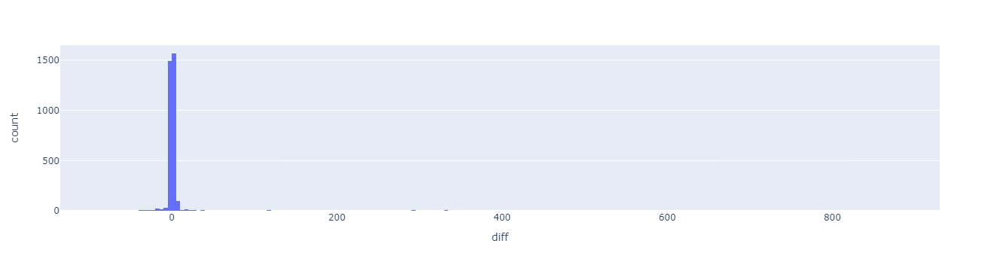

In [7]:
px.histogram(all_crossings, 'diff')

In [14]:
from pyspark.sql.functions import concat, col, lit, year, month
import plotly.express as px

track_df = spark.sql(f"""
    SELECT * 
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 1000000;
""")

track_pdf = track_df.toPandas()

track_pdf['event_time'] = pd.to_datetime(track_pdf['event_time'], unit='s')

def meters_to_flight_level(baro_altitude_meters):
    """
    Convert barometric altitude in meters to Flight Level.
    
    Parameters:
        baro_altitude_meters (float): Barometric altitude in meters.
        
    Returns:
        int: Flight Level in hundreds of feet.
    """
    if pd.isnull(baro_altitude_meters):
        return None
    # Convert altitude from meters to feet
    baro_altitude_feet = baro_altitude_meters * 3.28084
    
    # Calculate Flight Level
    flight_level = float(baro_altitude_feet / 100)
    
    return round(flight_level)

track_pdf['FL'] = track_pdf['baro_altitude'].apply(lambda l:meters_to_flight_level(l))

# FL of interest
FL = [40, 70, 100, 245]

FL_pdf = track_pdf[track_pdf['FL'].apply(lambda l:l in FL)] 

# Sort the DataFrame
df_sorted = FL_pdf.sort_values(['track_id', 'event_time', 'FL'])

# Drop duplicates based on 'track_id' and 'FL', keeping the first occurrence
df_first_FL = df_sorted.drop_duplicates(subset=['track_id', 'FL'], keep='first')
df_last_FL = df_sorted.drop_duplicates(subset=['track_id', 'FL'], keep='last')

df_first_FL['FL_first_last_seen'] = 'first'
df_last_FL['FL_first_last_seen'] = 'last'

df_first_last_FL = pd.concat([df_first_FL,df_last_FL])

track_pdf_fl = track_pdf.merge(df_first_last_FL[['track_id','event_time','FL_first_last_seen']], how='left',on=['track_id','event_time'])

track_pdf_fl['FL_first_last_seen'] = track_pdf_fl['FL_first_last_seen'].fillna('other')
#

TypeError: Invalid argument, not a string or column: 2.000000064 of type <class 'float'>. For column literals, use 'lit', 'array', 'struct' or 'create_map' function.

In [ ]:
track_pdf_fl_f = track_pdf_fl[track_pdf_fl['track_id']=='005e15fc80ff0f5235b8cfadfd0e6bbe1498688ad322dd3d5166b4086cf5943f_0_2022_12']

In [ ]:
px.scatter(track_pdf_fl_f, x='event_time',y='FL', color = 'FL_first_last_seen')

In [ ]:
# Show or store the result
#df_with_distances = df_with_distances.toPandas()

In [20]:
# Show or store the result
df = df.toPandas()

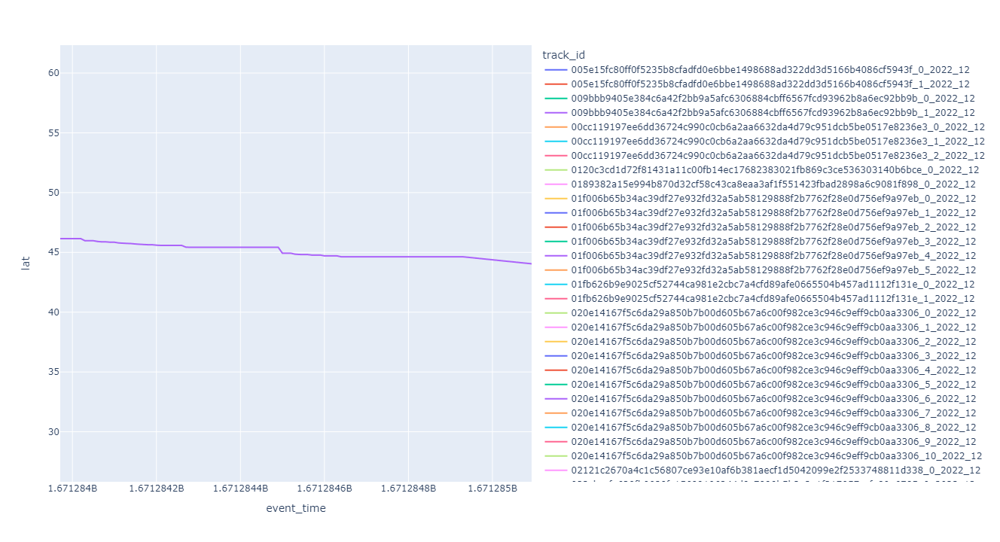

In [4]:
import plotly.express as px
px.line(df, x='event_time', y = 'lat', color='track_id')

In [21]:
df_t = df[df.track_id.str.contains('cd22d6')]

In [22]:
df_t = df_t.merge(df_t.groupby(['lat','lon']).count()['event_time'].reset_index().rename({'event_time':'count'},axis=1), on=['lat','lon'], how='left')

In [77]:
pd.Timestamp(1671281070, unit='s')-1670662810

Timestamp('2022-12-17 12:44:30')

In [78]:
pd.Timestamp(1670662810, unit='s')

Timestamp('2022-12-10 09:00:10')

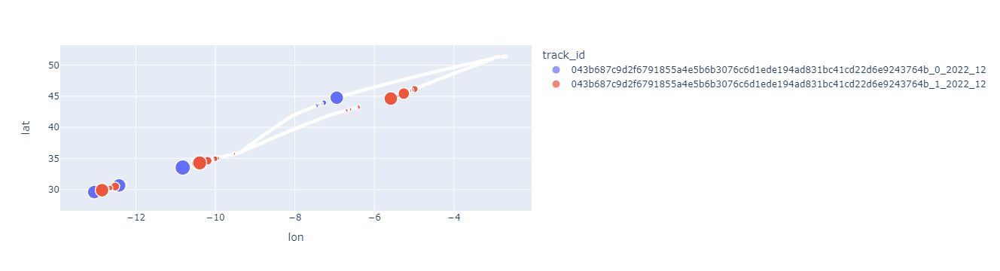

In [80]:
px.scatter(df_t, x='lon', y = 'lat', color='track_id', size = 'count')

In [26]:
df_t

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,spi,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,serials,track_id,h3_id_res_11,count
0,1670662660,40773b,51.384383,-2.715836,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a509fff,3
1,1670662660,40773b,51.384383,-2.715836,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a509fff,3
2,1670662660,40773b,51.384383,-2.715836,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a509fff,3
3,1670662670,40773b,51.384407,-2.715149,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a572fff,3
4,1670662670,40773b,51.384407,-2.715149,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a572fff,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5826,1671292190,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90
5827,1671292190,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90
5828,1671292200,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90
5829,1671292200,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90


In [24]:
test_df = pd.read_parquet('test_df.parquet')#spark.sql("""SELECT * FROM `project_aiu`.`osn_statevectors_clustered` WHERE icao24 = '40773b' and (event_time > 1670662660) and (event_time < 1671292200);""")
#test_df = test_df.toPandas()

In [32]:
test_df = test_df[test_df.callsign.fillna('').str.contains('TOM2HW')]

In [48]:
tmp = df_t[df_t.lat >= 44.76471][df_t.lat <= 44.76473]

/tmp/ipykernel_705/4030036247.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [68]:
tmp = tmp[[x for x in tmp.columns if x != 'serials']]

In [72]:
tmp

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,spi,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,track_id,h3_id_res_11,count
1158,1670666540,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1159,1670666540,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1160,1670666540,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1161,1670666550,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1162,1670666550,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1243,1670666820,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1244,1670666820,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1245,1670666830,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1246,1670666830,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90


In [ ]:
tmp[[x for x in tmp.columns if x != 'serials']].drop_duplicates

In [33]:
import plotly.express as px

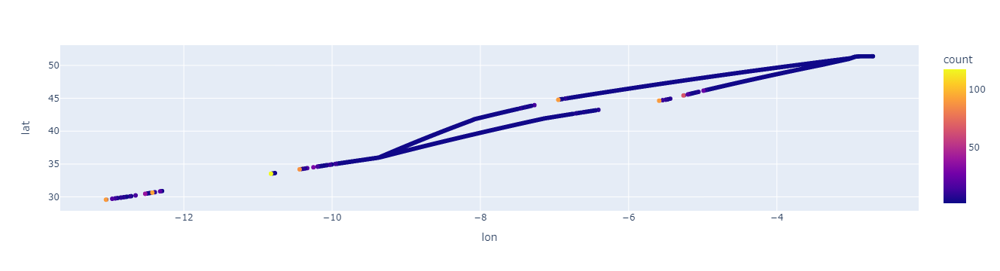

In [34]:
px.scatter(test_df, x='lon', y = 'lat', color='count')

In [ ]:
sv_df = spark.sql("""SELECT * FROM `project_aiu`.`osn_tracks_clustered` where callsign LIKE '%EXS94UJ%';""")
sv_df = sv_df.toPandas()

Hive Session ID = b3669249-b509-4c3d-ab28-fa72809a44ee


In [ ]:
sv_df

In [ ]:
sv_df['event_time'] = pd.to_datetime(sv_df['event_time'], unit = 's')

In [ ]:
f = np.logical_and(sv_df['event_time'] > pd.to_datetime('2022-07-22 21:00'), sv_df['event_time'] <= pd.to_datetime('2022-07-23 00:00'))

sv_df[f]

In [1]:
from traffic.data import opensky
flight = opensky.history(
    "2022-07-22 21:00",
    stop="2022-07-23 00:00",
    icao24="",
    # returns a Flight instead of a Traffic
    return_flight=True
)

Output()

/usr/local/lib/python3.9/site-packages/ipywidgets/widgets/widget_output.py:111: DeprecationWarning: 
Kernel._parent_header is deprecated in ipykernel 6. Use .get_parent()
  if ip and hasattr(ip, 'kernel') and hasattr(ip.kernel, '_parent_header'):

/usr/local/lib/python3.9/site-packages/traffic/data/adsb/opensky_impala.py:912: TqdmExperimentalWarning: rich is experimental/alpha
  for bt, at, bh, ah in progressbar(sequence):


/usr/local/lib/python3.9/site-packages/ipywidgets/widgets/widget_output.py:111: DeprecationWarning: 
Kernel._parent_header is deprecated in ipykernel 6. Use .get_parent()
  if ip and hasattr(ip, 'kernel') and hasattr(ip.kernel, '_parent_header'):

/usr/local/lib/python3.9/site-packages/ipywidgets/widgets/widget_output.py:111: DeprecationWarning: 
Kernel._parent_header is deprecated in ipykernel 6. Use .get_parent()
  if ip and hasattr(ip, 'kernel') and hasattr(ip.kernel, '_parent_header'):

In [3]:
flight.data

,alert,altitude,callsign,geoaltitude,groundspeed,hour,icao24,last_position,latitude,longitude,onground,spi,squawk,timestamp,track,vertical_rate
0,False,36000.0,NaN,NaN,NaN,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,None,2022-07-22 21:10:27+00:00,NaN,NaN
1,False,36000.0,NaN,NaN,NaN,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:28+00:00,NaN,NaN
2,False,36000.0,NaN,38325.0,442.0,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:29+00:00,20.404228,0.0
3,False,36000.0,NaN,38325.0,442.0,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:30+00:00,20.404228,0.0
4,False,36000.0,NaN,38325.0,442.0,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:31+00:00,20.404228,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3594,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:55+00:00,88.698047,-128.0
3595,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:56+00:00,88.698047,-128.0
3596,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:57+00:00,88.698047,-128.0
3597,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:58+00:00,88.698047,-128.0


In [11]:
fdf.groupby(['latitude','longitude']).count()['hour'].reset_index().rename({'hour':'count'},axis=1)

,latitude,longitude,count
0,36.751316,-11.147617,61
1,36.867416,-11.093854,181
2,37.211288,-10.933442,1
3,37.214905,-10.931747,5
4,37.222843,-10.927993,43
...,...,...,...
4864,52.830692,-1.344962,1
4865,52.830738,-1.343706,3
4866,52.830780,-1.339493,31
4867,52.831158,-1.319332,21


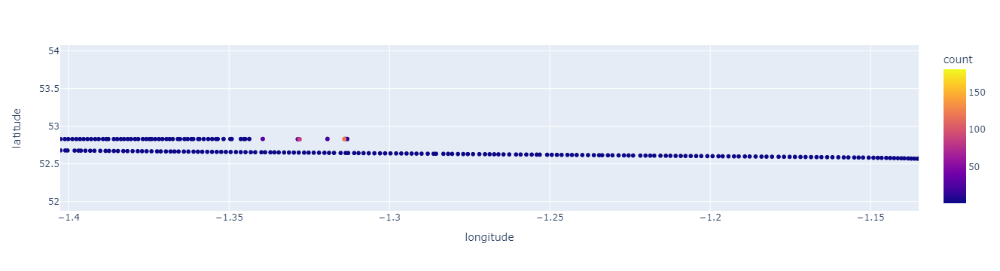

In [13]:
import plotly.express as px

fdf = flight.data
fdf = fdf.merge(fdf.groupby(['latitude','longitude']).count()['hour'].reset_index().rename({'hour':'count'},axis=1), on=['latitude','longitude'], how='left')

px.scatter(fdf, x='longitude', y = 'latitude', color = 'count')

In [2]:
df = spark.sql("""
    SELECT 
        icao24,
        flt_id,
        track_id,
        adep,
        adep_min_distance_km,
        adep_min_distance_time,
        ades,
        ades_min_distance_km,
        ades_min_distance_time
    FROM `project_aiu`.`osn_flight_table`
    WHERE ADEP IS NOT NULL AND ADES IS NOT NULL
    LIMIT 100000;
""")


pdf = df.toPandas()

pdf['adep_min_distance_time'] = pd.to_datetime(pdf['adep_min_distance_time'], unit='s')
pdf['ades_min_distance_time'] = pd.to_datetime(pdf['ades_min_distance_time'], unit='s')
pdf['time'] = pdf['ades_min_distance_time'] - pdf['adep_min_distance_time']
pdf['time_in_hours'] = pdf['time'].dt.total_seconds() / 3600.0

Hive Session ID = 0e077670-d7e7-4b94-947a-9752ee42a9f7


In [3]:
track_ids = pdf.track_id[:10].to_list()
track_ids_str = ', '.join([f"'{track_id}'" for track_id in track_ids])

In [4]:
# Complete the SQL query


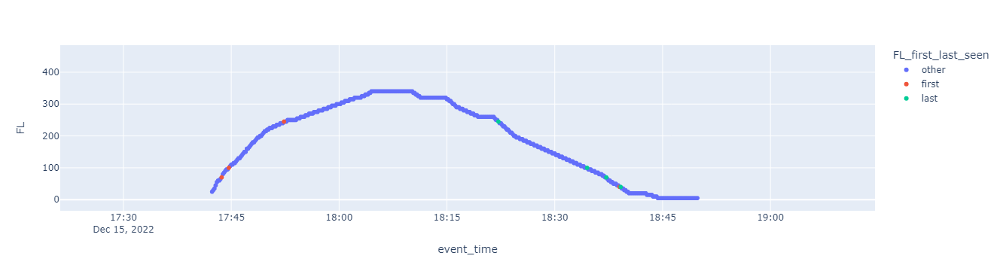

In [25]:
track_pdf

,event_time,icao24,lat,lon,on_ground,velocity,heading,vert_rate,callsign,squawk,baro_altitude,geo_altitude,serials,track_id,FLIGHT_LEVEL
0,2022-12-15 17:42:20,002e2a,48.364792,11.803401,False,92.201799,87.121631,13.65504,SPKCK,6666,746.76,716.28,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,24.0
1,2022-12-15 17:42:20,002e2a,48.364792,11.803401,False,92.201799,87.121631,13.65504,SPKCK,6666,746.76,716.28,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,24.0
2,2022-12-15 17:42:30,002e2a,48.365215,11.816519,False,100.574789,85.893503,16.25600,SPKCK,6666,891.54,853.44,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,29.0
3,2022-12-15 17:42:30,002e2a,48.365215,11.816519,False,100.574789,85.893503,16.25600,SPKCK,6666,891.54,853.44,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,29.0
4,2022-12-15 17:42:40,002e2a,48.366611,11.829746,False,98.195488,75.745349,26.98496,SPKCK,6666,1150.62,1127.76,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,37.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14380,2022-11-05 16:59:30,003e53,34.780946,33.506012,False,97.557357,47.136911,0.00000,JDI20B,7110,586.74,655.32,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0
14381,2022-11-05 16:59:40,003e53,34.790582,33.518658,False,92.846810,47.470051,-0.32512,JDI20B,7110,594.36,662.94,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0
14382,2022-11-05 16:59:40,003e53,34.790582,33.518658,False,92.846810,47.470051,-0.32512,JDI20B,7110,594.36,662.94,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0
14383,2022-11-05 16:59:50,003e53,34.795982,33.525639,False,86.625404,46.925184,-2.92608,JDI20B,7110,579.12,647.70,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0


In [24]:
track_df 

DataFrame[event_time: string, icao24: string, lat: double, lon: double, on_ground: boolean, velocity: double, heading: double, vert_rate: double, callsign: string, squawk: string, baro_altitude: double, geo_altitude: double, serials: array<int>, track_id: string]